In [ ]:
! pip install segment-geospatial

In [ ]:
# Importing the necessary libraries
import os
import leafmap
from samgeo import SamGeo, show_image, download_file, overlay_images, tms_to_geotiff

In [ ]:
m = leafmap.Map(center =  [5.12220, -1.29396], zoom = 17, height = '500px', width = '800px')
m.add_basemap('SATELLITE')
m

Map(center=[5.1222, -1.29396], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zo…

In [ ]:
# AOI
if  m.user_roi_bounds() is not None:
  bbox = m.user_roi_bounds()
else:
  bbox = [5.10561, -1.29076, 5.12561, -1.29076]

In [ ]:
# Download Image
image = 'satellite.tiff'
tms_to_geotiff(
    output = image,
    bbox = bbox,
    zoom = 20, source = 'Satellite',
    overwrite = True
)

Downloaded image 01/96
Downloaded image 02/96
Downloaded image 03/96
Downloaded image 04/96
Downloaded image 05/96
Downloaded image 06/96
Downloaded image 07/96
Downloaded image 08/96
Downloaded image 09/96
Downloaded image 10/96
Downloaded image 11/96
Downloaded image 12/96
Downloaded image 13/96
Downloaded image 14/96
Downloaded image 15/96
Downloaded image 16/96
Downloaded image 17/96
Downloaded image 18/96
Downloaded image 19/96
Downloaded image 20/96
Downloaded image 21/96
Downloaded image 22/96
Downloaded image 23/96
Downloaded image 24/96
Downloaded image 25/96
Downloaded image 26/96
Downloaded image 27/96
Downloaded image 28/96
Downloaded image 29/96
Downloaded image 30/96
Downloaded image 31/96
Downloaded image 32/96
Downloaded image 33/96
Downloaded image 34/96
Downloaded image 35/96
Downloaded image 36/96
Downloaded image 37/96
Downloaded image 38/96
Downloaded image 39/96
Downloaded image 40/96
Downloaded image 41/96
Downloaded image 42/96
Downloaded image 43/96
Downloaded 

In [ ]:
# own image specify the local path to the image

In [ ]:
# Display Downloaded Image
m.layers[-1].visible = False
m.add_raster(image, layer_name = 'Image')
m

Map(bottom=32599511.01477292, center=[5.1172, -1.2923499999999999], controls=(ZoomControl(options=['position',…

In [ ]:
# Initialize SAM
# Specify the file path to the model check point. If not specified, the model will be abandoned
# to the working directory

sam = SamGeo(
    model_type = 'vit_h',
    sam_kwargs = None,
)

Model checkpoint for vit_h not found.


Downloading...
From: https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
To: /root/.cache/torch/hub/checkpoints/sam_vit_h_4b8939.pth
100%|██████████| 2.56G/2.56G [00:15<00:00, 170MB/s]


**Automatic Mask Generation**

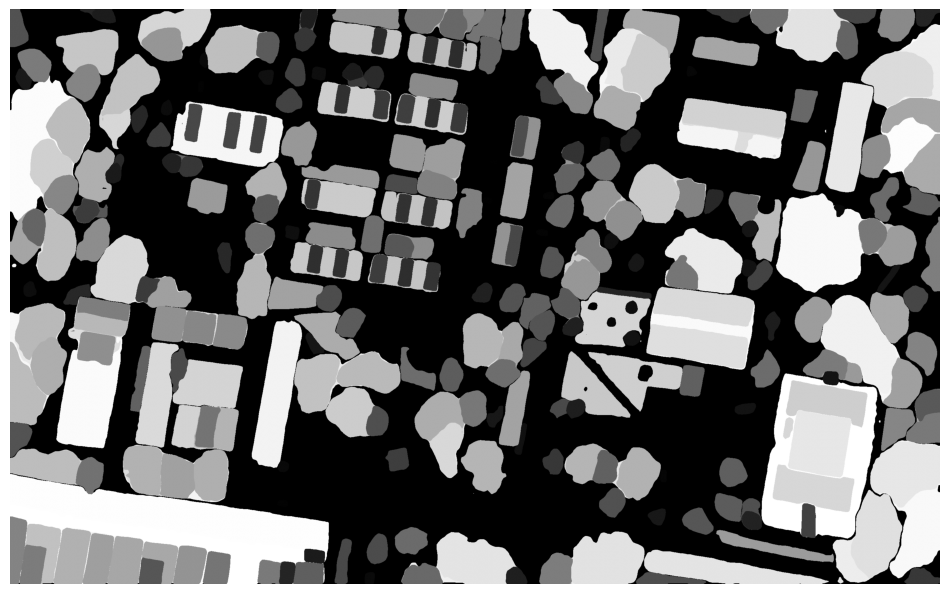

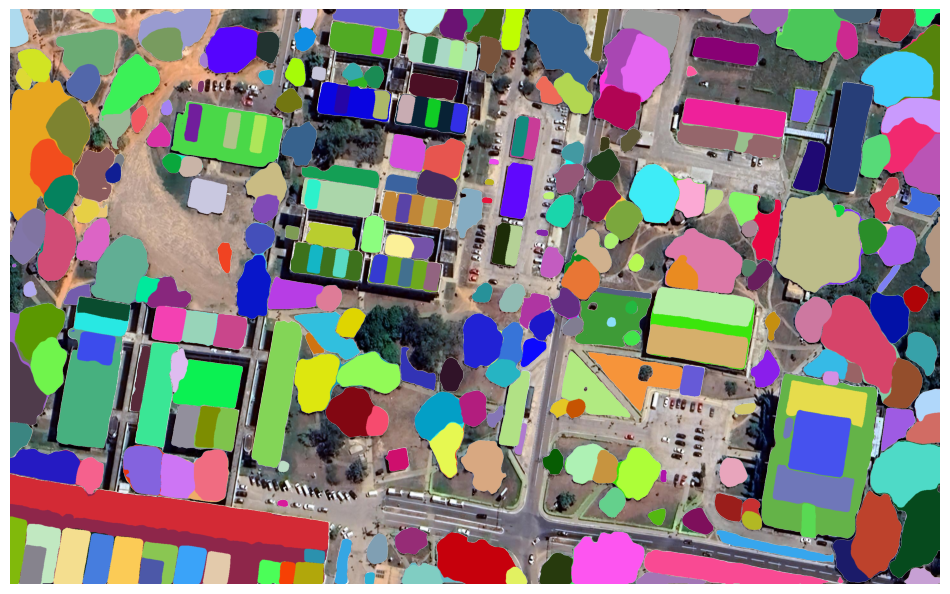

In [ ]:
# Segment the image and save the results to a GeoTIFF file.
# Set unique to True in order to assign a unique id to each object

sam.generate(
    image, output = 'mask.tiff',
    foreground = True,
    unique = True
)

sam.show_masks(cmap = 'binary_r')
# Show the object annotations (objects with random color) on the map
sam.show_anns(
    axis = 'off',
    alpha =1,
    output = 'annotations.tiff'
)


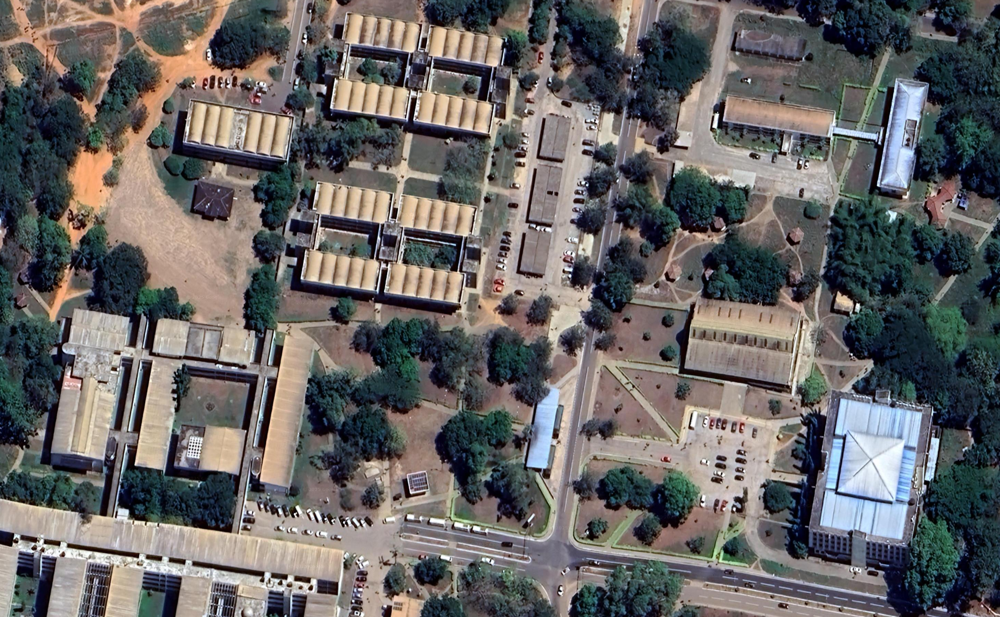
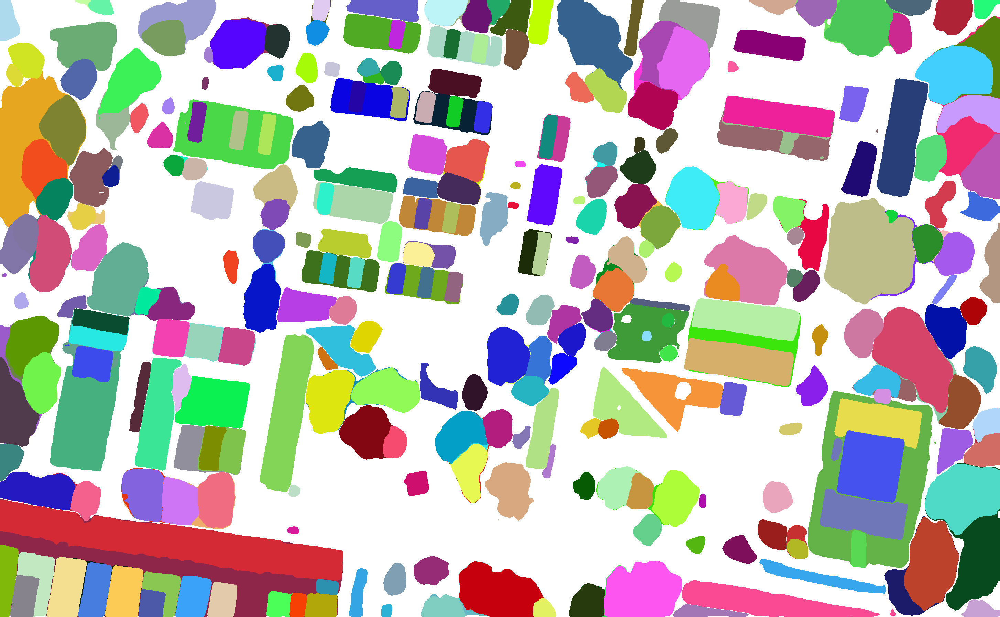

In [ ]:
# Comparing Images with a slider
leafmap.image_comparison(
    'satellite.tiff',
    'annotations.tiff',
    label1 = 'Satellite Image',
    label2 = 'Image Segmentation'
)

In [ ]:
# Add Image to Map
m.add_raster(
    'annotations.tiff',
    alpha = 0.5,
    layer_name = 'Masks'
)
m

In [ ]:
# Convert Objects annotation to vector format

sam.tiff_to_vector('mask.tiff', 'masks.gpkg')

**Automatic Mask Generation Options**

There are severaal tunable parameters in the automatic mask generation that control how densely points are sampled and what the thresholds are for removing low quality or duplicates masks. Additionally, generation can be automatically run on crops of the image to get improved performance on smaller objects and post-processing can remove stray pixels and holes.

In [ ]:
sam_kwargs = {
    'points_per_side' : 32,
    'pred_iou_thresh' : 0.86,
    'stability_score_thresh':0.92,
    'crop_n_layers' : 1,
    'crop_n_points_downscale_factor' : 2,
    'min_mask_region_area' : 100
}

In [ ]:
sam1 = SamGeo(
    model_type = 'vit_h',
    sam_kwargs = sam_kwargs
)

In [ ]:
sam.generate(
    image, ouput = 'mask1.tiff', foreground = True
)

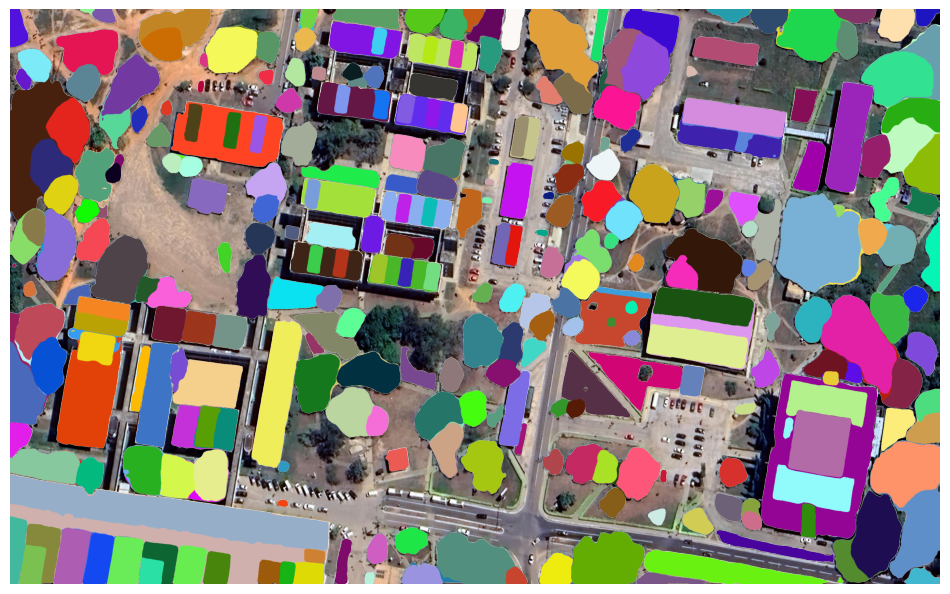

In [ ]:
sam.show_anns(
    axis = 'off',
    alpha = 1,
    output = 'annotations1.tiff'
)



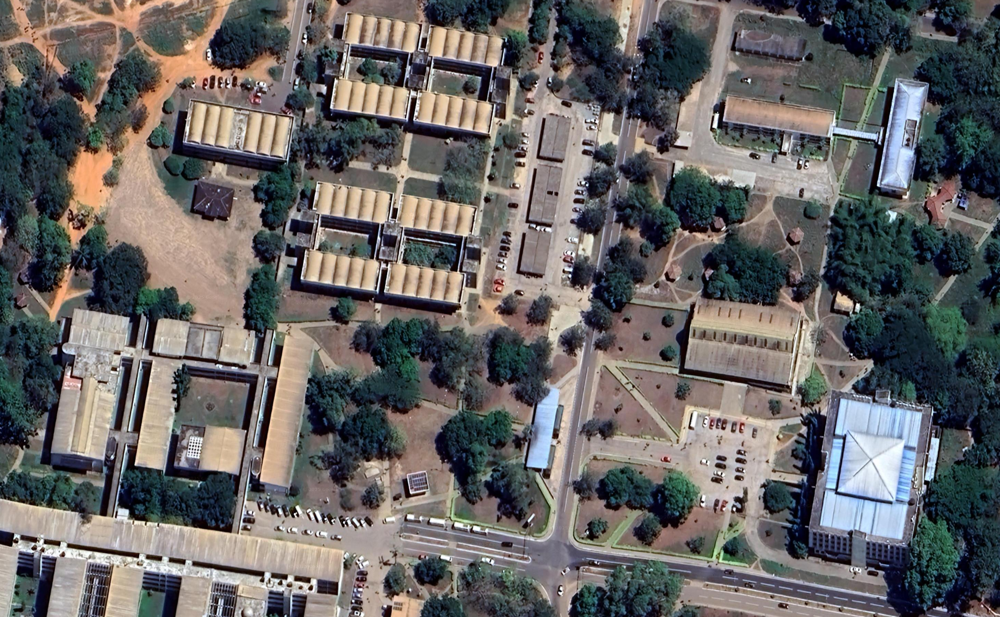
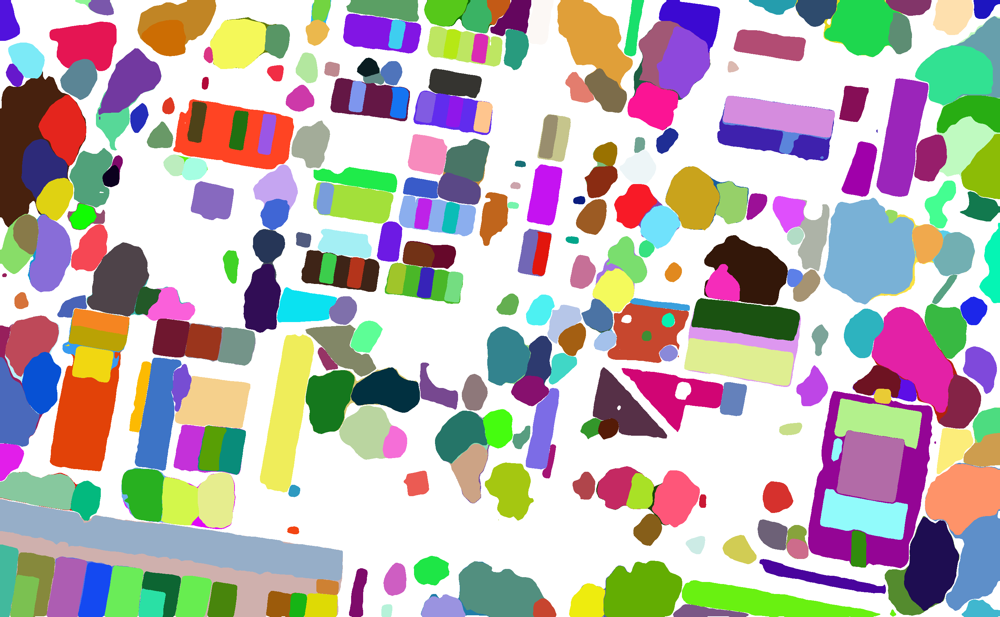

In [ ]:
# Compare
leafmap.image_comparison(
    image,
    'annotations1.tiff',
    label1 = 'Images',
    label2 = 'Segmented Image'
)

Overlay the annotations on the image and use the slider to change the opacity interactively

In [ ]:
overlay_images(
    image,
    'annotations1.tiff',
    backend='Agg'

)

The TkAgg backend is not supported in Google Colab. The overlay_images function will not work on Colab.


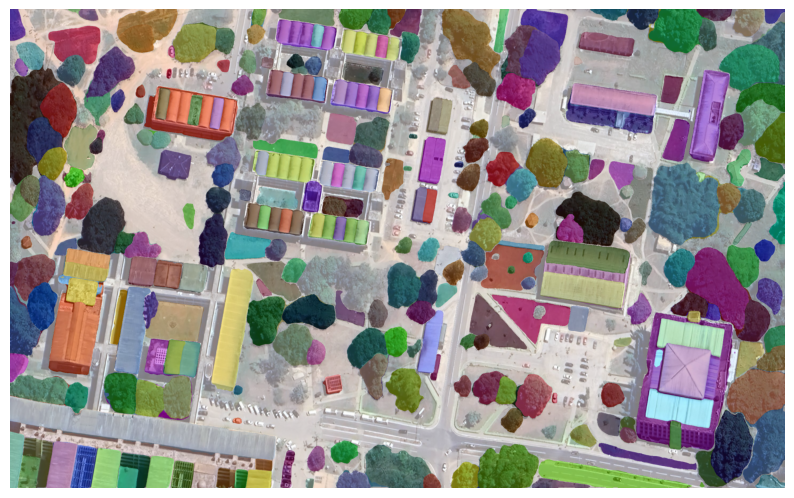

In [ ]:
import matplotlib.pyplot as plt
from skimage import io

# Load images (replace with your actual paths)
base_image = io.imread(image)
overlay_image = io.imread('annotations1.tiff')

# Create figure with proper size
plt.figure(figsize=(10, 8))

# Display base image
plt.imshow(base_image)

# Overlay with transparency
plt.imshow(overlay_image, alpha=0.5)  # Adjust alpha (0-1) for transparency

# Remove axes for cleaner display
plt.axis('off')

# Show the combined image
plt.show()
